In [1]:
import pandas as pd

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

import geopandas as gpd
import numpy as np
from tqdm import tqdm_notebook
from shapely.geometry import Point, LineString
import os

from datetime import datetime, timedelta

import matplotlib.pyplot as plt
%matplotlib inline

import folium
import geoplot


data_path = '/home/fterroso/data/'
tweets_path = '/home/fterroso/projects/twitter-crawler/streaming_tweets/'

### Read province

In [2]:
province_gdf = gpd.read_file(os.path.join('data', 'provinces_with_code.geojson'), encoding='utf-8').to_crs({'init': 'epsg:25830'})
province_gdf.head()

,NATCODE,NAMEUNIT,CODEUNIT,geometry
0,34104600000,València/Valencia,46,(POLYGON ((653037.6610938488 4429500.236400451...
1,34084500000,Toledo,45,"POLYGON ((294238.4652867644 4416957.42816667, ..."
2,34024400000,Teruel,44,"POLYGON ((765333.0112961649 4512252.350615062,..."
3,34094300000,Tarragona,43,(POLYGON ((813560.4348489635 4504876.753000001...
4,34074200000,Soria,42,"POLYGON ((583890.5889343297 4603311.305096235,..."


### Read trips

Read csv generated in notebook 3c

In [3]:
prov_trips_gdf = gpd.read_file(os.path.join('data', 'province_trips_consecutive.geojson'), 
                          driver='GeoJSON', 
                          encoding='utf-8').to_crs({'init': 'epsg:25830'})
prov_trips_gdf['timestamp_o']= pd.to_datetime(prov_trips_gdf['timestamp_o'])
prov_trips_gdf['timestamp_d']= pd.to_datetime(prov_trips_gdf['timestamp_d'])

In [4]:
prov_trips_gdf.shape

(153724, 8)

In [5]:
prov_trips_gdf['dist_km'] = prov_trips_gdf['geometry'].apply(lambda r: r.length/1000)

In [6]:
prov_trips_gdf['time_length']= prov_trips_gdf['timestamp_d'] - prov_trips_gdf['timestamp_o']

## Study of number of trips per type hour

In [7]:
max_time_length= 100

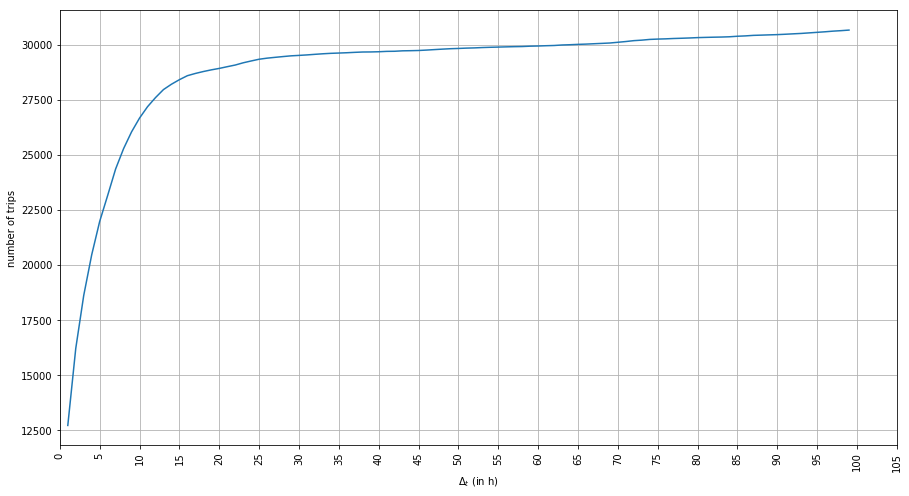

In [8]:
 n_trips = []
for h in tqdm_notebook(range(1,max_time_length)):
    r_trips_gdf = prov_trips_gdf[(prov_trips_gdf['time_length']>timedelta(minutes=1))&(prov_trips_gdf['time_length']<=timedelta(hours=h))]
    n_trips.append((h,r_trips_gdf.shape[0]))
n_trips_df = pd.DataFrame.from_records(n_trips, columns='h n_trips'.split())
ax= n_trips_df.plot(x='h', y='n_trips', rot=90, grid=True, figsize=(15,8));
ax.xaxis.set_ticks(np.arange(0,max_time_length+10,5));
ax.get_legend().remove()
ax.set_ylabel('number of trips');
ax.set_xlabel(r'$\Delta_t$ (in h)');
plt.savefig(os.path.join('figs','delta_time_evol.png'))

We only keep trips with time lenghts between 1 minute and 24 hours

In [9]:
prov_trips_gdf = prov_trips_gdf[(prov_trips_gdf['time_length']>timedelta(minutes=1))&(prov_trips_gdf['time_length']<=timedelta(hours=24))]

In [10]:
def calculate_speed_fn(row):
    return row['dist_km']/(row['time_length'].total_seconds()/3600)

In [11]:
prov_trips_gdf['speed_km_h'] = prov_trips_gdf.apply(calculate_speed_fn, axis=1)

In [12]:
prov_trips_gdf= prov_trips_gdf[prov_trips_gdf['speed_km_h'] <=500]

In [13]:
prov_trips_gdf.head()

,user_id,tw_id_o,timestamp_o,PROV_o,tw_id_d,timestamp_d,PROV_d,geometry,dist_km,time_length,speed_km_h
28,550261599,1271251707662487553,2020-06-12 01:23:20+00:00,Lleida,1271300070848073728,2020-06-12 04:35:31+00:00,Madrid,LINESTRING (801799.4858383657 4613560.58154440...,385.841286,03:12:11,120.460379
34,550261599,1235822698179080192,2020-03-06 07:01:06+00:00,Barcelona,1235848984700149760,2020-03-06 08:45:33+00:00,Madrid,LINESTRING (936098.3485898112 4599731.93930922...,509.802161,01:44:27,292.849494
53,550261599,1263866722945134598,2020-05-22 16:18:02+00:00,Madrid,1263890111114051585,2020-05-22 17:50:59+00:00,Girona,LINESTRING (441970.6228863231 4474288.59112672...,594.252450,01:32:57,383.594911
63,550261599,1249736667495370753,2020-04-13 16:30:15+00:00,Madrid,1249757472350285825,2020-04-13 17:52:55+00:00,Murcia,LINESTRING (441970.6228863231 4474288.59112672...,373.985274,01:22:40,271.440924
73,550261599,1254589140030550017,2020-04-27 01:52:14+00:00,Madrid,1254636101488107521,2020-04-27 04:58:51+00:00,Barcelona,LINESTRING (441970.6228863231 4474288.59112672...,505.474929,03:06:37,162.517616


In [14]:
prov_trips_gdf.shape

(20220, 11)

In [15]:
prov_trips_gdf.crs

{'init': 'epsg:25830'}

In [16]:
prov_trips_gdf.head()

,user_id,tw_id_o,timestamp_o,PROV_o,tw_id_d,timestamp_d,PROV_d,geometry,dist_km,time_length,speed_km_h
28,550261599,1271251707662487553,2020-06-12 01:23:20+00:00,Lleida,1271300070848073728,2020-06-12 04:35:31+00:00,Madrid,LINESTRING (801799.4858383657 4613560.58154440...,385.841286,03:12:11,120.460379
34,550261599,1235822698179080192,2020-03-06 07:01:06+00:00,Barcelona,1235848984700149760,2020-03-06 08:45:33+00:00,Madrid,LINESTRING (936098.3485898112 4599731.93930922...,509.802161,01:44:27,292.849494
53,550261599,1263866722945134598,2020-05-22 16:18:02+00:00,Madrid,1263890111114051585,2020-05-22 17:50:59+00:00,Girona,LINESTRING (441970.6228863231 4474288.59112672...,594.252450,01:32:57,383.594911
63,550261599,1249736667495370753,2020-04-13 16:30:15+00:00,Madrid,1249757472350285825,2020-04-13 17:52:55+00:00,Murcia,LINESTRING (441970.6228863231 4474288.59112672...,373.985274,01:22:40,271.440924
73,550261599,1254589140030550017,2020-04-27 01:52:14+00:00,Madrid,1254636101488107521,2020-04-27 04:58:51+00:00,Barcelona,LINESTRING (441970.6228863231 4474288.59112672...,505.474929,03:06:37,162.517616


### Plot distribution of trips features

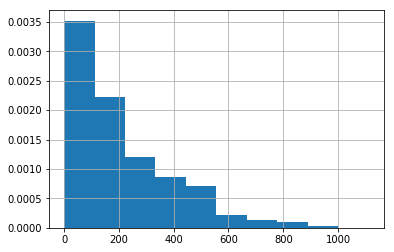

In [17]:
prov_trips_gdf['dist_km'].hist(density=True);

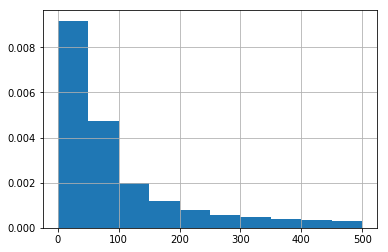

In [18]:
prov_trips_gdf['speed_km_h'].hist(density=True);

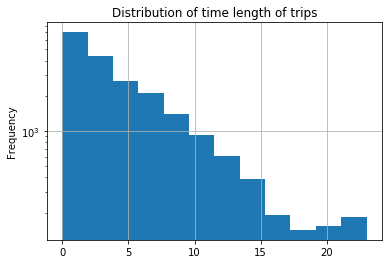

In [19]:
(prov_trips_gdf['time_length'].astype('timedelta64[h]')).plot.hist(bins=12, logy=True, grid=True, title="Distribution of time length of trips");

### Number of trips inter-province

In [20]:
prov_trips_gdf[prov_trips_gdf['PROV_o']!=prov_trips_gdf['PROV_d']].shape

(20220, 11)

### Calculate stats of provinces

In [21]:
def generate_stats_per_prov_fn(trips_gdf, trip_edge, prov_granularity):
    count_df = trips_gdf.groupby('{}_{}'.format(prov_granularity, trip_edge)).count()['tw_id_{}'.format(trip_edge)].to_frame()
    count_df.columns= ['n_trips']#.format(prov_granularity).split()
    count_df.sort_values(by='n_trips', ascending=False, inplace=True)
    return count_df

Province study

In [22]:
count_origin_df = generate_stats_per_prov_fn(prov_trips_gdf, 'o', 'PROV')

In [23]:
count_origin_df.head()

,n_trips
PROV_o,
Madrid,3211
Barcelona,2057
Sevilla,1117
Cuenca,840
Tarragona,784


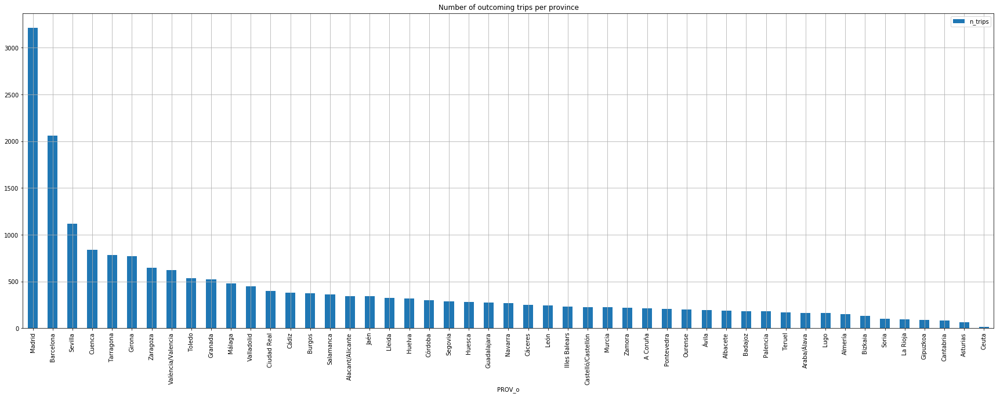

In [24]:
count_origin_df[0:100].plot(figsize=(30,10),kind='bar', grid=True, title='Number of outcoming trips per province');

### Plot province origin trips in map

In [25]:
origin_regions_lst = count_origin_df.index.tolist()

In [26]:
t_provinces_gdf = pd.merge(province_gdf, count_origin_df.reset_index(), left_on='NAMEUNIT', right_on='PROV_o')

In [27]:
t_provinces_gdf.head()

,NATCODE,NAMEUNIT,CODEUNIT,geometry,PROV_o,n_trips
0,34104600000,València/Valencia,46,(POLYGON ((653037.6610938488 4429500.236400451...,València/Valencia,623
1,34084500000,Toledo,45,"POLYGON ((294238.4652867644 4416957.42816667, ...",Toledo,536
2,34024400000,Teruel,44,"POLYGON ((765333.0112961649 4512252.350615062,...",Teruel,170
3,34094300000,Tarragona,43,(POLYGON ((813560.4348489635 4504876.753000001...,Tarragona,784
4,34074200000,Soria,42,"POLYGON ((583890.5889343297 4603311.305096235,...",Soria,98


In [28]:
t_provinces_gdf.shape

(49, 6)

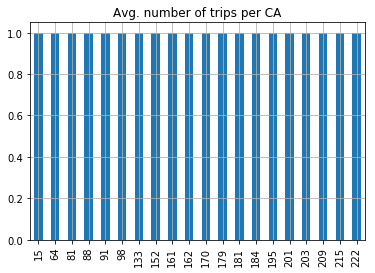

In [29]:
t_provinces_gdf['n_trips'].value_counts().sort_index(axis=0)[:20].plot(kind='bar', grid=True, title="Avg. number of trips per CA");

In [30]:
t_provinces_gdf['n_trips'].max()

3211

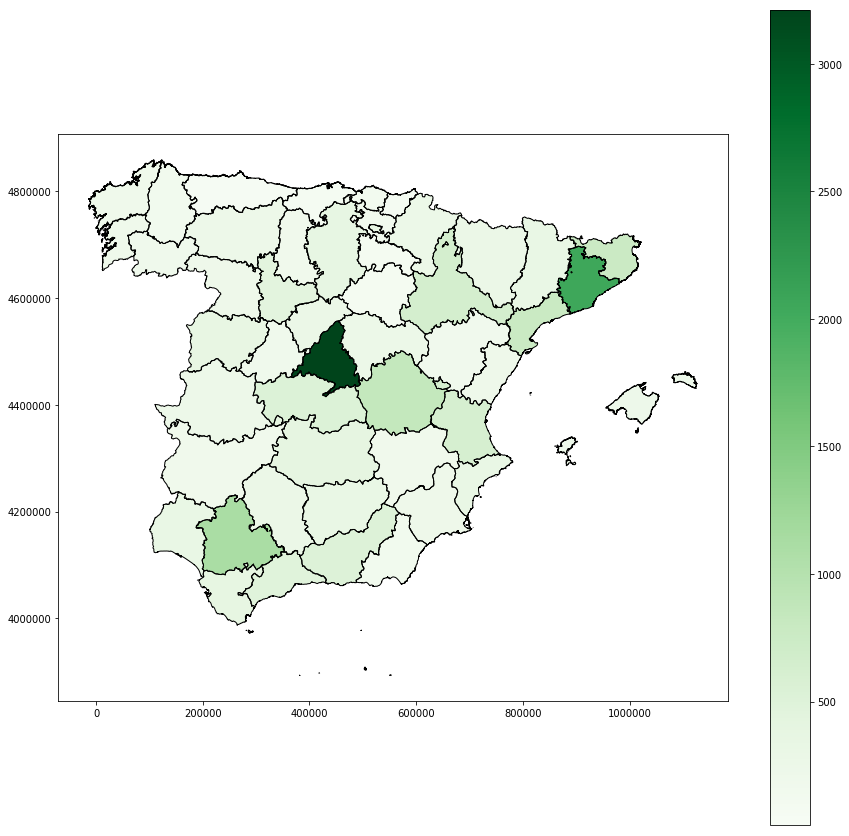

In [31]:
ax=t_provinces_gdf.plot(figsize=(15,15), column='n_trips', legend=True, cmap='Greens');
province_gdf.geometry.boundary.plot(color=None,edgecolor='k',linewidth = 1,ax=ax); 
plt.savefig(os.path.join('figs','twt_trips_geo_dist.png'))

-----------------------------------

In [32]:
def add_map_layer(folium_map, gdf, layer_name, column_names):
    folium.GeoJson(gdf,
                   tooltip=folium.features.GeoJsonTooltip(fields=column_names, localize=True),
                   style_function= lambda x:{
                   'opacity': 0.6,
                   'fillOpacity': 0.0,
                   },
                   name=layer_name).add_to(folium_map);

In [33]:
def generate_trip_map_fn(trips_gdf):
    """
    origin_areas = trips_gdf['CUSEC_o'].unique().tolist()
    destination_areas = trips_gdf['CUSEC_d'].unique().tolist()
    target_areas_lst = origin_areas + destination_areas
    target_zones_gdf = zones_gdf[zones_gdf['CUSEC'].isin(target_areas_lst)]
    """
    
    trips_gdf['timestamp_o'] = trips_gdf['timestamp_o'].astype(str)
    trips_gdf['timestamp_d'] = trips_gdf['timestamp_d'].astype(str)

    #print(target_zones_gdf)
    spain_map = folium.Map([40.411644, -3.657904], zoom_start = 6)
    
    add_map_layer(spain_map, province_gdf[['NAMEUNIT', 'geometry']], 'prov',['NAMEUNIT'])
    
    add_map_layer(spain_map, 
                  trips_gdf['user_id dist_km timestamp_o timestamp_d speed_km_h geometry'.split()], 
                  'trips', 
                  ['user_id','dist_km','timestamp_o','timestamp_d','speed_km_h'])
    return spain_map

In [34]:
d=prov_trips_gdf.sample(50)

In [35]:
d

,user_id,tw_id_o,timestamp_o,PROV_o,tw_id_d,timestamp_d,PROV_d,geometry,dist_km,time_length,speed_km_h
127981,800896548,1281561034592059398,2020-07-10 12:08:55+00:00,Madrid,1281677086739042310,2020-07-10 19:50:04+00:00,Valladolid,LINESTRING (440369.1666405275 4481029.29208996...,160.226483,07:41:09,20.846989
19161,907116427538296833,1243339651475218433,2020-03-27 00:50:47+00:00,Zaragoza,1243619099005116421,2020-03-27 19:21:13+00:00,Alacant/Alicante,LINESTRING (676311.2868775467 4613116.15014872...,375.520499,18:30:26,20.290484
100161,993579473638391809,1238417492013432833,2020-03-13 10:51:53+00:00,Madrid,1238489669899354112,2020-03-13 15:38:41+00:00,Toledo,LINESTRING (440369.1666405275 4481029.29208996...,76.618070,04:46:48,16.028885
120088,2228545328,1234107856812740608,2020-03-01 13:26:56+00:00,Ciudad Real,1234259596031778821,2020-03-01 23:29:53+00:00,Granada,LINESTRING (456329.4551422716 4276877.44865275...,162.093407,10:02:57,16.130035
95541,792340678466568193,1239555674318782465,2020-03-16 14:14:37+00:00,Zamora,1239652235904266246,2020-03-16 20:38:19+00:00,Cuenca,LINESTRING (241010.3101535688 4655338.10489929...,400.501266,06:23:42,62.627250
142237,978694713166516225,1256518054982422528,2020-05-02 09:37:03+00:00,Cáceres,1256541421487763456,2020-05-02 11:09:54+00:00,Toledo,LINESTRING (240465.4371362604 4376016.82315917...,112.150832,01:32:51,72.472266
7588,974022020,1255026815636209664,2020-04-28 06:51:24+00:00,Cuenca,1255030589444546560,2020-04-28 07:06:24+00:00,Madrid,LINESTRING (498853.3990707324 4427310.20104474...,68.329912,00:15:00,273.319647
13506,709417970347466754,1245637094950617088,2020-04-02 09:00:00+00:00,Girona,1245652195086716928,2020-04-02 10:00:01+00:00,Barcelona,LINESTRING (1011731.856006955 4658901.85674297...,102.345415,01:00:01,102.316994
30088,1011638875746439169,1289396707692695554,2020-08-01 03:05:05+00:00,Burgos,1289526827195670528,2020-08-01 11:42:08+00:00,Valladolid,LINESTRING (419646.7812385056 4607287.50606353...,108.595928,08:37:03,12.601790
134923,246370615,1239590594420277248,2020-03-16 16:33:22+00:00,Girona,1239645905227259904,2020-03-16 20:13:09+00:00,Barcelona,"LINESTRING (978522.51368257 4657670.481015417,...",85.052503,03:39:47,23.219004


In [36]:
generate_trip_map_fn(d)

## Study of the evolution of the trips

In [37]:
prov_trips_gdf['date_o']= prov_trips_gdf['timestamp_o'].dt.date

In [38]:
prov_trips_gdf.head(3)

,user_id,tw_id_o,timestamp_o,PROV_o,tw_id_d,timestamp_d,PROV_d,geometry,dist_km,time_length,speed_km_h,date_o
28,550261599,1271251707662487553,2020-06-12 01:23:20+00:00,Lleida,1271300070848073728,2020-06-12 04:35:31+00:00,Madrid,LINESTRING (801799.4858383657 4613560.58154440...,385.841286,03:12:11,120.460379,2020-06-12
34,550261599,1235822698179080192,2020-03-06 07:01:06+00:00,Barcelona,1235848984700149760,2020-03-06 08:45:33+00:00,Madrid,LINESTRING (936098.3485898112 4599731.93930922...,509.802161,01:44:27,292.849494,2020-03-06
53,550261599,1263866722945134598,2020-05-22 16:18:02+00:00,Madrid,1263890111114051585,2020-05-22 17:50:59+00:00,Girona,LINESTRING (441970.6228863231 4474288.59112672...,594.252450,01:32:57,383.594911,2020-05-22


In [39]:
n_trips_per_day = prov_trips_gdf.groupby('date_o').size()

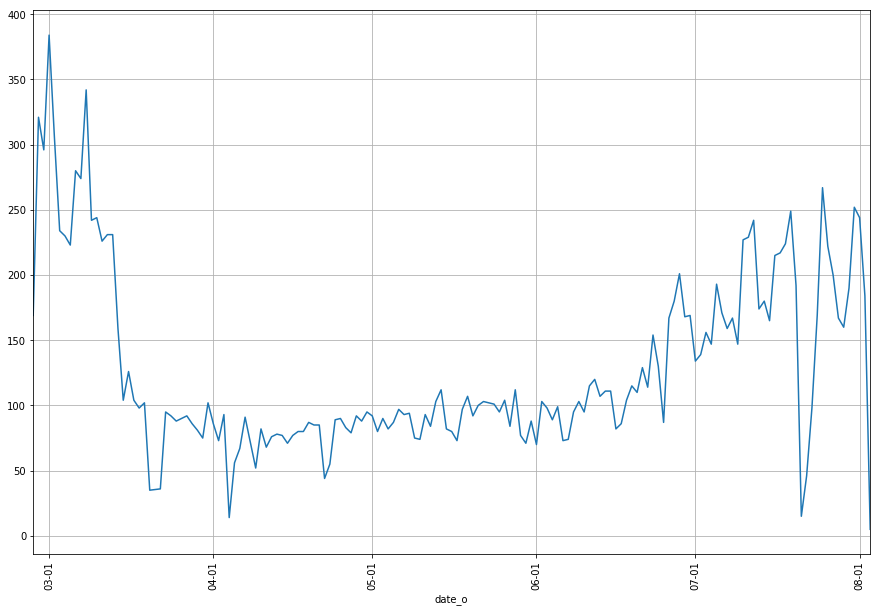

In [40]:
import matplotlib.dates as mdates
ax= n_trips_per_day.plot(grid=True, rot=90, figsize=(15,10));
ax.xaxis.set_major_formatter(mdates.DateFormatter("%m-%d"))
ax.xaxis.set_minor_formatter(mdates.DateFormatter("%m-%d"))

In [41]:
prov_trips_gdf['time_length'] = prov_trips_gdf['time_length'].apply(lambda x: x.seconds)
prov_trips_gdf['timestamp_o'] = prov_trips_gdf['timestamp_o'].astype(str)
prov_trips_gdf['timestamp_d'] = prov_trips_gdf['timestamp_d'].astype(str)
prov_trips_gdf.drop(columns='date_o').to_file(os.path.join('data', 'province_consecutive_enriched.geojson'), driver='GeoJSON', encoding='utf-8')